# 3. Exploratory Data Analysis 

## 3.1 Read data

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import norm
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
df = pd.read_csv('train.csv')

## 3.2 Correlation Matrix

### 3.2.1 Correlation Matrix with heatmap

<AxesSubplot:>

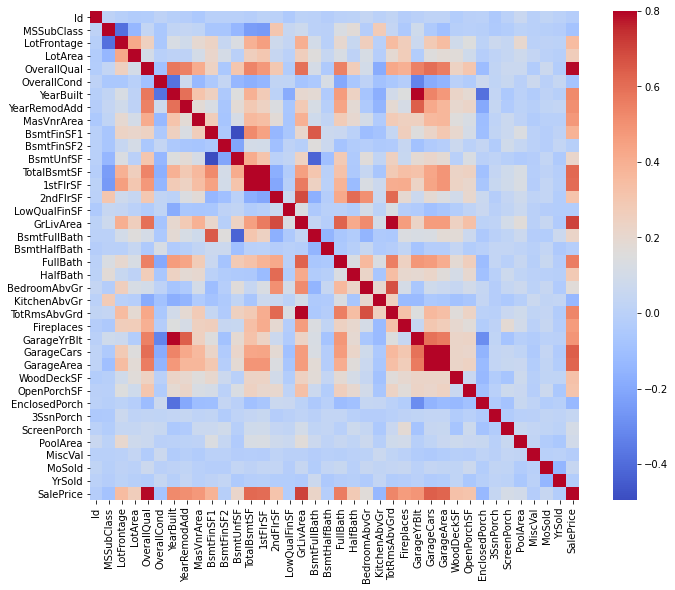

In [4]:
# Correlation matrix
corrmat = df.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=.8, square=True,cmap="coolwarm")

From above matrix we can see that features like OverallQual, GrLivArea, GarageArea, GarageCars,YearBuilt etc have strong correlation with SalesPrice.

### 3.2.2 Top correlations with sales price

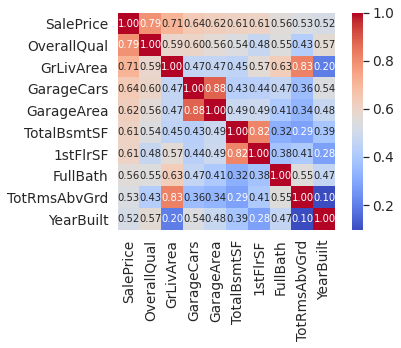

In [5]:
# Top feature correlation with SalesPrice 
k = 10 #number of variables for heatmap
cols = corrmat.nlargest(k, 'SalePrice')['SalePrice'].index
cm = np.corrcoef(df[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values, cmap="coolwarm")
plt.show()

## 3.3 Pair Plots

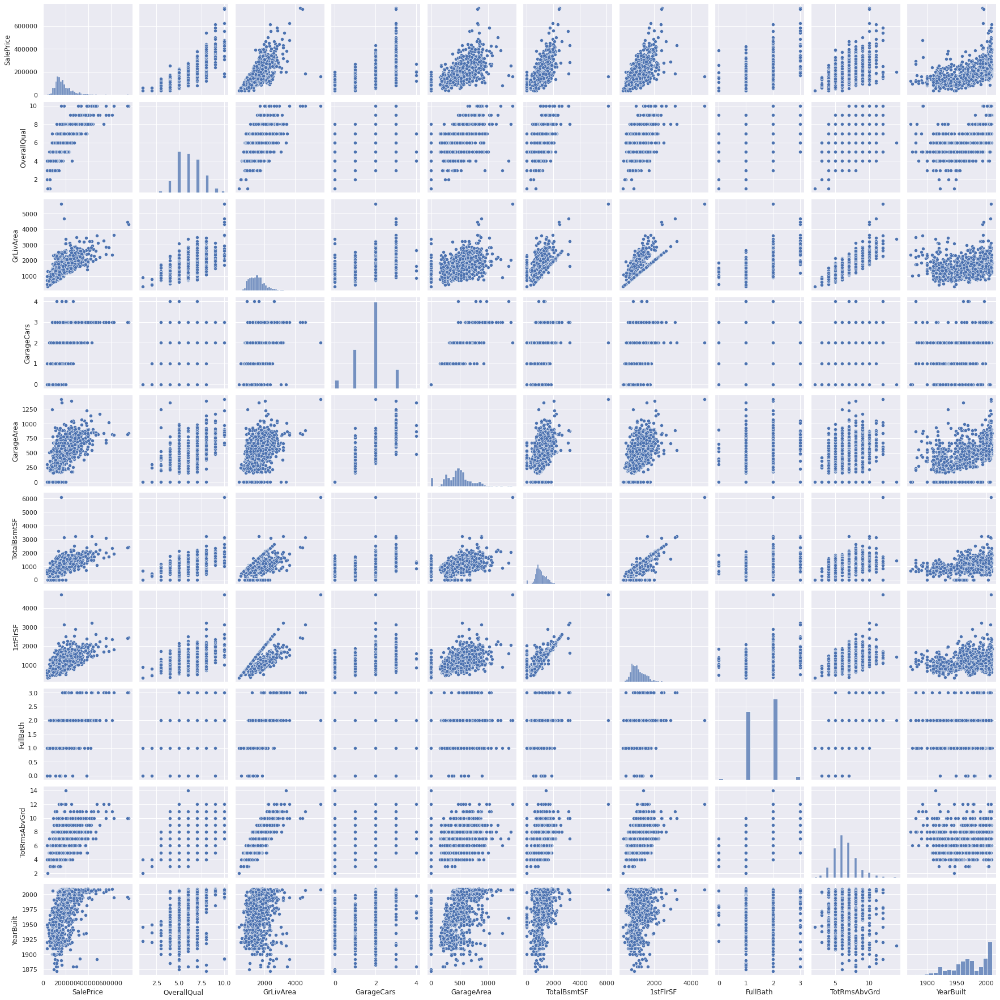

In [6]:
#scatterplot
sns.set()
# cols = ['SalePrice', 'OverallQual', 'GrLivArea', 'GarageArea','GarageCars', 'TotalBsmtSF', 'FullBath', 'YearBuilt']
sns.pairplot(df[cols], height = 2.5)
plt.show();

## 3.4 Scatter Plots

In [7]:
# functuion to plot scatter plot
def scatterPlot(feature):
    plt.scatter(df[feature], df['SalePrice'], alpha=0.5)
    plt.xlabel(feature)
    plt.ylabel("Sale Price")
    plt.show()

### 3.4.1 Ground living area

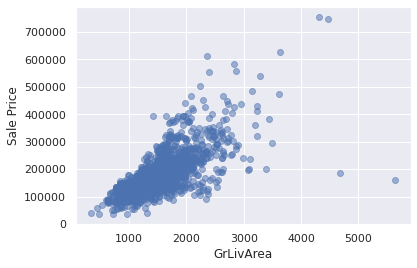

In [9]:
scatterPlot('GrLivArea')

### 3.4.2 Garage Area

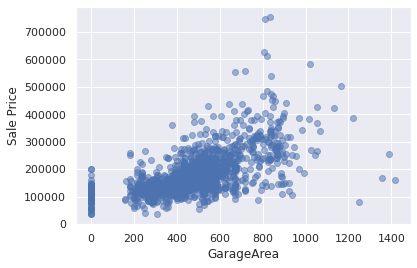

In [10]:
scatterPlot('GarageArea')

### 3.4.3 First Floor square feet

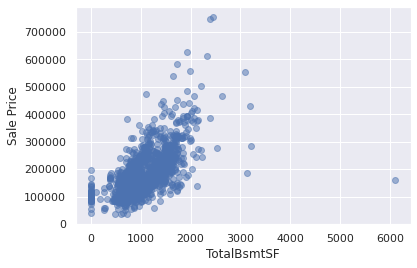

In [11]:
scatterPlot('TotalBsmtSF') 

### 3.4.5 Year built

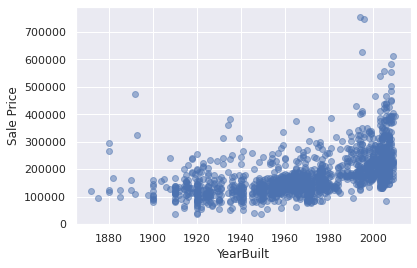

In [13]:
scatterPlot('YearBuilt')

From above plots we can see each of these features have a somewhat linear relationship with Sales Price.

## 3.5 Distribution Plots

### 3.5.1 Sale Price

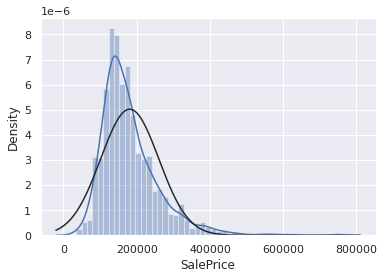

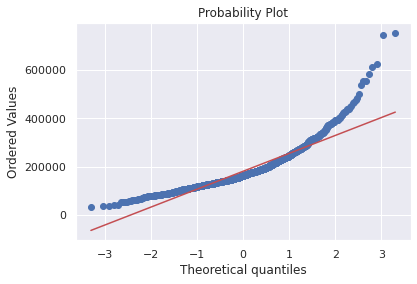

In [14]:
#histogram and normal probability plot
sns.distplot(df['SalePrice'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)

'SalePrice' is not normal. It shows 'peakedness', positive skewness and does not follow the diagonal line.
We can log transform this feature to get normal distribution.

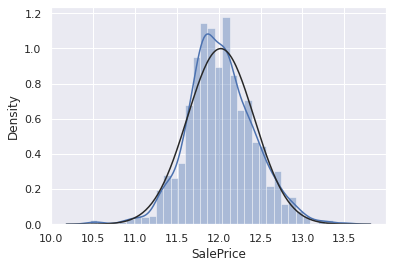

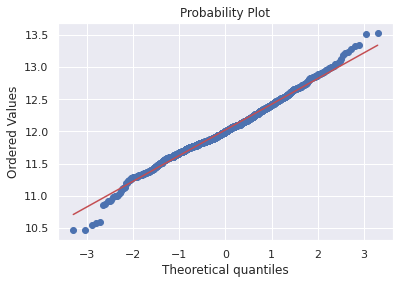

In [15]:
# Applying log transformation
df['SalePrice'] = np.log(df['SalePrice'])

# Transformed histogram and normal probability plot
sns.distplot(df['SalePrice'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)

Similarly we will use same techniqe to normalize the skiwness of the feature.

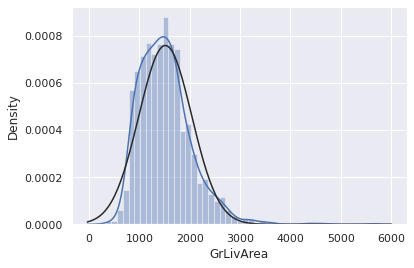

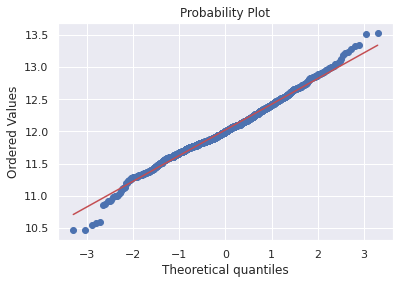

In [16]:
sns.distplot(df['GrLivArea'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)

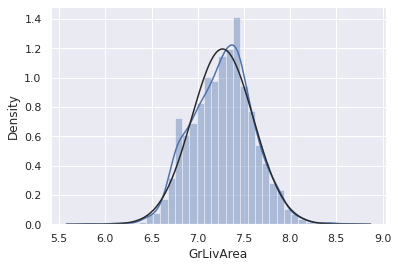

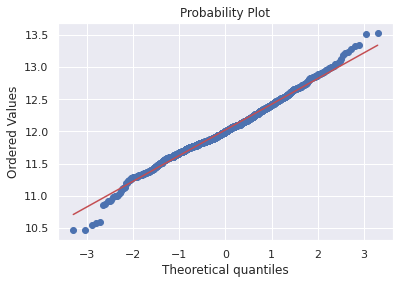

In [17]:
# Data transformation
df['GrLivArea'] = np.log(df['GrLivArea'])
sns.distplot(df['GrLivArea'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['SalePrice'], plot=plt)

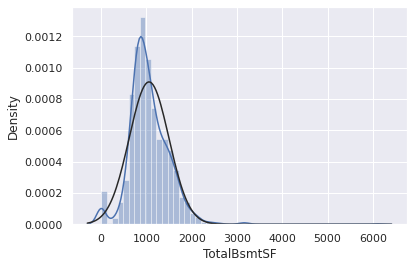

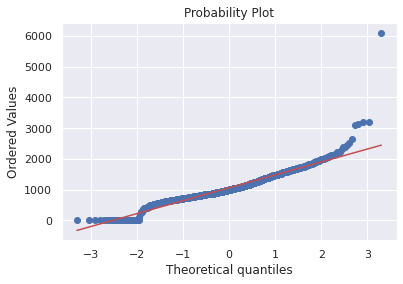

In [18]:
sns.distplot(df['TotalBsmtSF'], fit=norm);
fig = plt.figure()
res = stats.probplot(df['TotalBsmtSF'], plot=plt)

In TotalBsmtSF alot of datapoints have zero values, we have to log transform without affecting them.

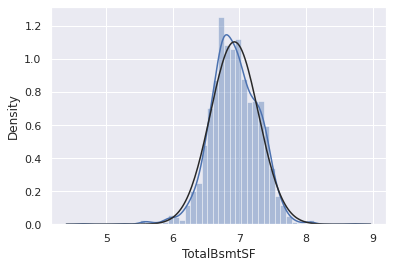

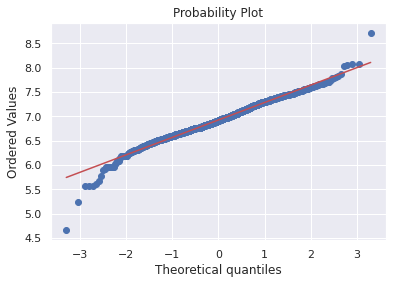

In [20]:
df['TotalBsmtSF'] = df['TotalBsmtSF'].apply(lambda x: np.log(x) if x != 0 else x)

sns.distplot(df[df['TotalBsmtSF']>0]['TotalBsmtSF'], fit=norm);
fig = plt.figure()
res = stats.probplot(df[df['TotalBsmtSF']>0]['TotalBsmtSF'], plot=plt)